# Simulación de Propagación de WannaCry con Modelo SIRP

Este notebook permite simular y visualizar la propagación del ransomware WannaCry utilizando un modelo SIRP (Susceptibles-Infectados-Removidos-Protegidos) en una red de 256 equipos.

In [1]:
# Importar librerías necesarias
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import networkx as nx
from tqdm import tqdm
import ipywidgets as widgets
from IPython.display import display, HTML

# Importar nuestro modelo SIRP
from modelo_sirp_rk4 import ModeloSIRP
from interfaz_interactiva_rk4 import iniciar_interfaz

## 1. Simulación de Escenarios

Primero, vamos a simular todos los escenarios definidos en el modelo:

In [2]:
# Crear instancia del modelo
modelo = ModeloSIRP()

# Simular todos los escenarios
modelo.simular_todos_escenarios()

Simulando escenarios:   0%|                                | 0/5 [00:00<?, ?it/s]

Simulando escenarios: 100%|████████████████████████| 5/5 [00:00<00:00, 87.38it/s]

## 2. Visualización de Curvas SIRP

Ahora visualizamos las curvas SIRP para cada escenario:

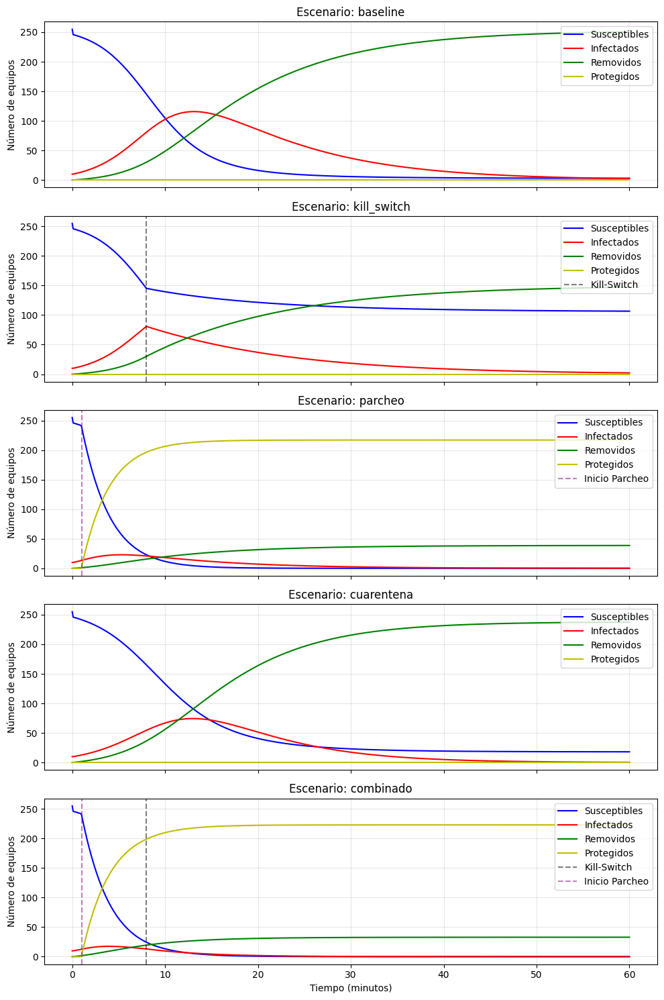

In [3]:
# Graficar curvas para todos los escenarios
fig, axs = modelo.graficar_curvas()
plt.show()

## 3. Animación de la Propagación en Red

Podemos visualizar la propagación del ransomware en la red para cada escenario:

In [4]:
# Seleccionar un escenario para animar
escenario = 'baseline'  # Cambiar a 'kill_switch', 'parcheo', 'cuarentena' o 'combinado'

# Crear animación
ani, fig = modelo.animar_propagacion(escenario)
plt.close()  # Cerrar la figura para evitar duplicados

# Mostrar animación
from IPython.display import HTML
HTML(ani.to_jshtml())

Animation size has reached 21416762 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## 4. Comparación de Escenarios

Comparemos la evolución de los infectados en todos los escenarios:

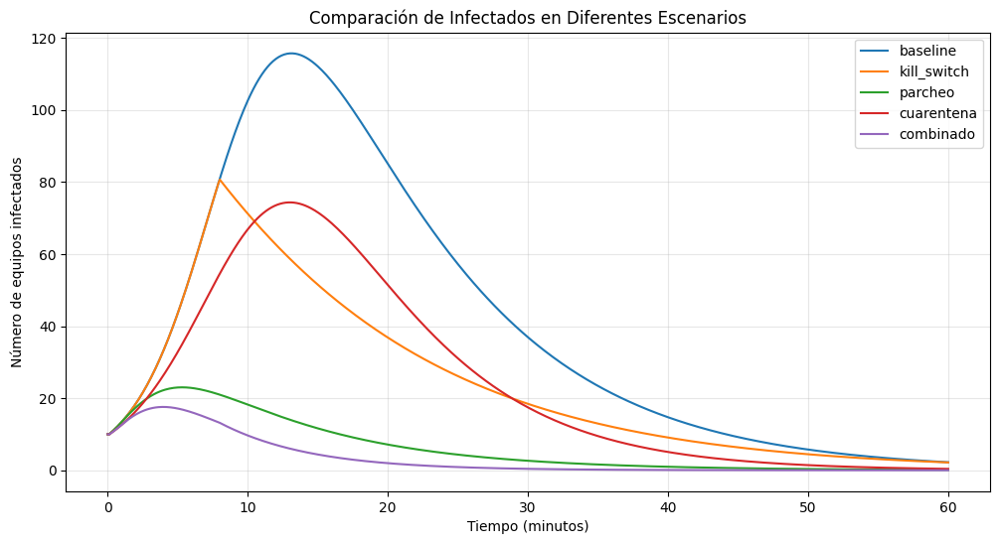

In [5]:
# Graficar curvas de infectados para todos los escenarios
plt.figure(figsize=(12, 6))

for nombre, res in modelo.resultados.items():
    plt.plot(res['tiempo'], res['I'], label=nombre)

plt.title('Comparación de Infectados en Diferentes Escenarios')
plt.xlabel('Tiempo (minutos)')
plt.ylabel('Número de equipos infectados')
plt.grid(True, alpha=0.3)
plt.legend()
plt.show()

## 5. Interfaz Interactiva

Finalmente, podemos explorar los resultados con una interfaz interactiva:

In [6]:
# Iniciar interfaz interactiva
interfaz = iniciar_interfaz()

Simulando escenarios:   0%|                                | 0/5 [00:00<?, ?it/s]

Simulando escenarios: 100%|████████████████████████| 5/5 [00:00<00:00, 97.59it/s]

## 6. Guardar Animaciones

Para guardar las animaciones como archivos MP4 (requiere ffmpeg):

Creando animación para escenario: baseline


Creando animación para escenario: kill_switch


Creando animación para escenario: parcheo


Creando animación para escenario: cuarentena


Creando animación para escenario: combinado


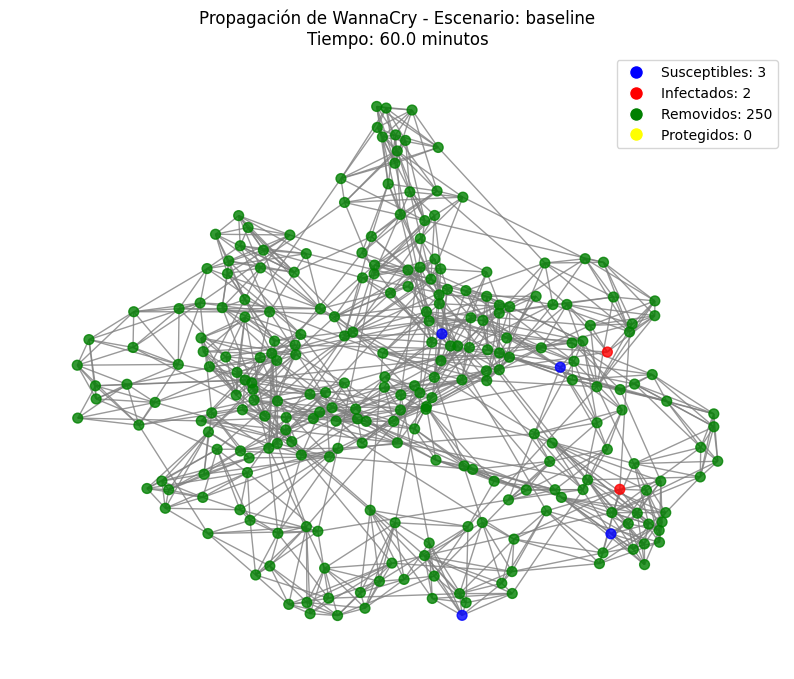

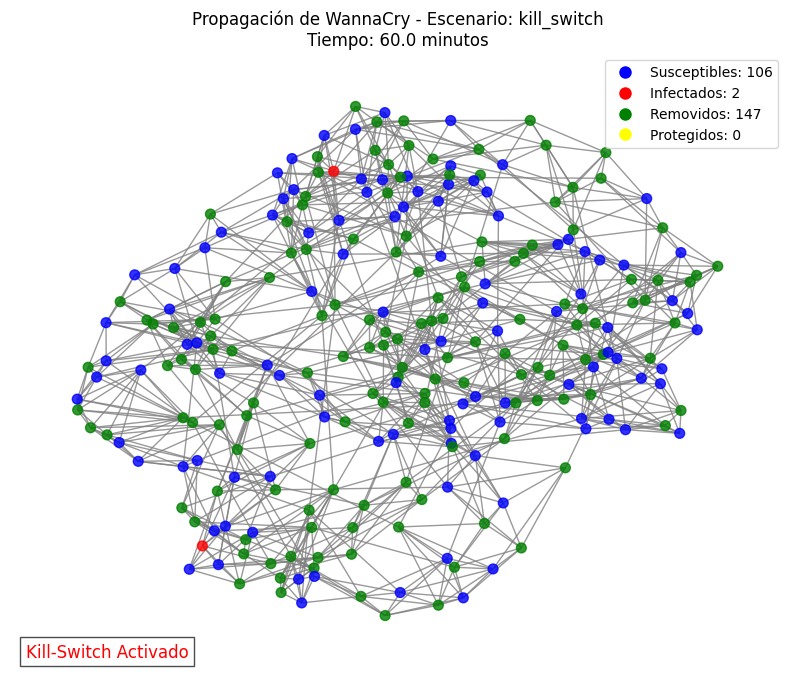

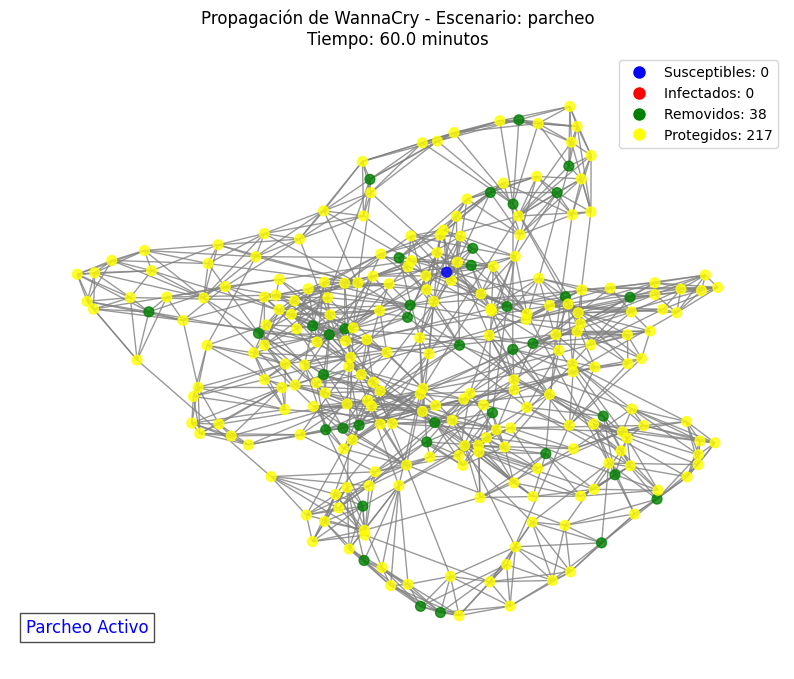

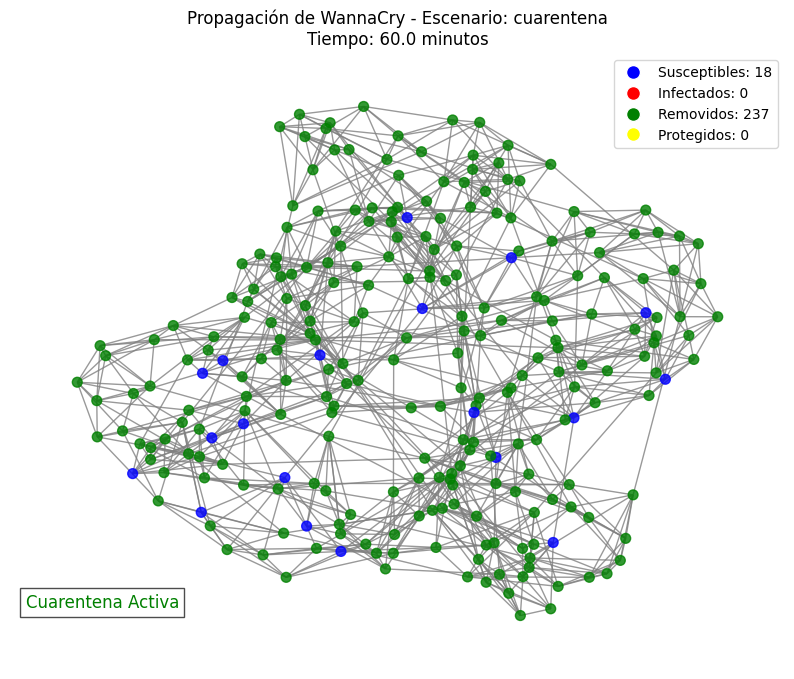

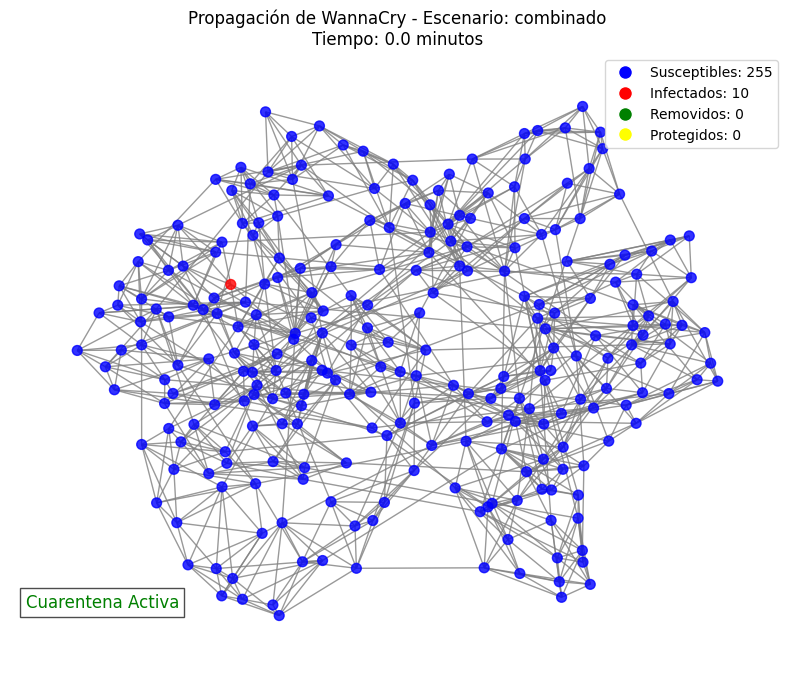

In [7]:
# Guardar animaciones para todos los escenarios
for escenario in modelo.escenarios:
    print(f"Creando animación para escenario: {escenario}")
    modelo.animar_propagacion(escenario, guardar=True)